Importar archivos desde github

In [1]:
import os

REPO_NAME = "computer_vision"
if REPO_NAME not in os.getcwd():
  if not os.path.exists(REPO_NAME):
    !git clone https://github.com/santiiferrero/{REPO_NAME}
  os.chdir(REPO_NAME)


Cloning into 'computer_vision'...
remote: Enumerating objects: 36, done.
remote: Counting objects: 100% (36/36), done.
remote: Compressing objects: 100% (34/34), done.
remote: Total 36 (delta 3), reused 0 (delta 0), pack-reused 0
Receiving objects: 100% (36/36), 34.96 MiB | 15.42 MiB/s, done.
Resolving deltas: 100% (3/3), done.


# Ejercicio 1
Elija una de las imágenes color que tomó para la clase y aplique separación de canales y elija un método para transformarla en escala de grises. Muestre por pantalla los resultados obtenidos.



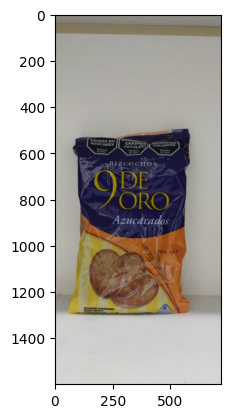

(<Figure size 640x480 with 1 Axes>,
 None)

In [2]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image   # Pillow --> https://pillow.readthedocs.io/en/stable/

imagen ='/content/computer_vision/unidad1/imagen1.jpeg'

# --- Imagen RGB ------------------------------------------------------------------------
img = cv2.imread(imagen)
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
plt.figure(1), plt.imshow(img), plt.show(block=False)

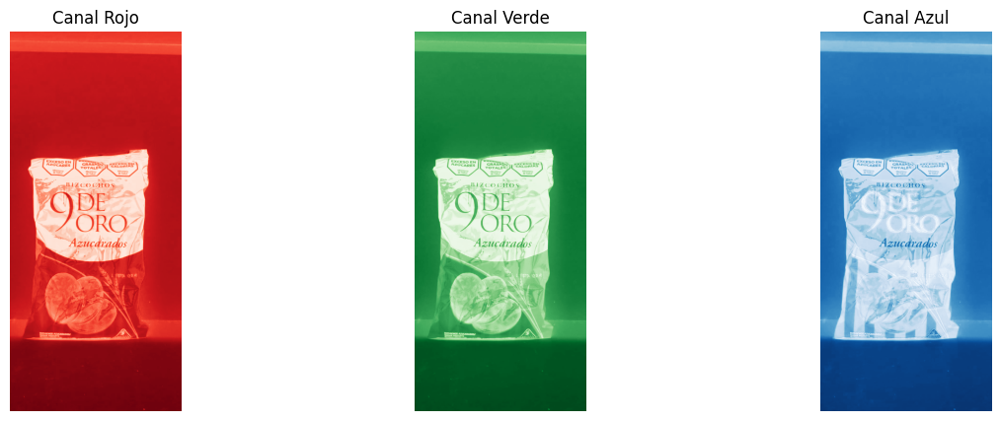

In [3]:
# Separar la imagen en los canales de color R, G, B
R, G, B = img[:,:,0], img[:,:,1], img[:,:,2]
# Paso 5: Mostrar cada canal de color
fig, axs = plt.subplots(1, 3, figsize=(15, 5))

axs[0].imshow(R, cmap='Reds')
axs[0].set_title('Canal Rojo')
axs[0].axis('off')

axs[1].imshow(G, cmap='Greens')
axs[1].set_title('Canal Verde')
axs[1].axis('off')

axs[2].imshow(B, cmap='Blues')
axs[2].set_title('Canal Azul')
axs[2].axis('off')

plt.show()

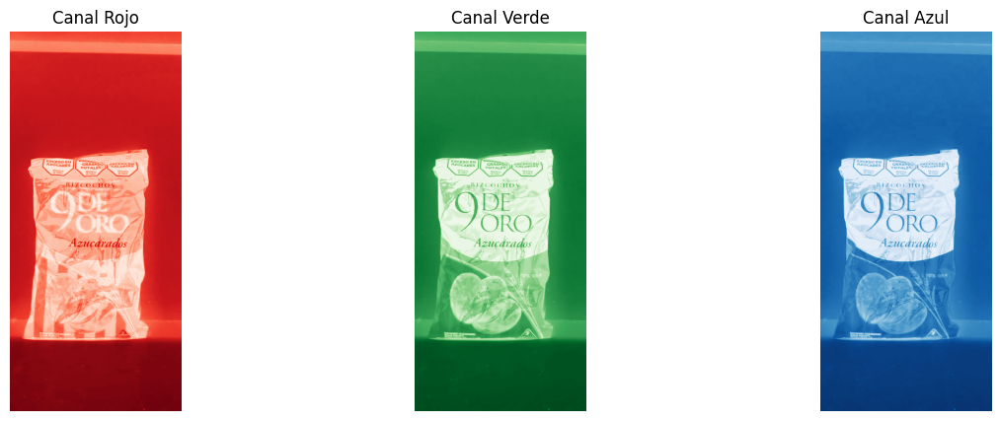

In [4]:
# --- Separar canales -------------------------------------------------------------------
B, G, R = cv2.split(img)
# Paso 5: Mostrar cada canal de color
fig, axs = plt.subplots(1, 3, figsize=(15, 5))

axs[0].imshow(R, cmap='Reds')
axs[0].set_title('Canal Rojo')
axs[0].axis('off')

axs[1].imshow(G, cmap='Greens')
axs[1].set_title('Canal Verde')
axs[1].axis('off')

axs[2].imshow(B, cmap='Blues')
axs[2].set_title('Canal Azul')
axs[2].axis('off')

plt.show()

Shape de la imagen original (RGB): (1600, 720, 3)
Tipo de dato del array de la imagen original: uint8
Shape de la imagen en escala de grises: (1600, 720)
Tipo de dato del array de la imagen en escala de grises: uint8


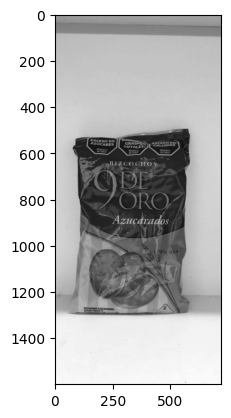

In [5]:
#gray=cv2.imread('/content/WhatsApp Image 2024-03-21 at 14.05.19.jpeg', cv2.IMREAD_GRAYSCALE)
# Convertir la imagen a escala de grises
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

# Imprimir el shape y el tipo de dato del array de la imagen original y en escala de grises
print(f"Shape de la imagen original (RGB): {img.shape}")
print(f"Tipo de dato del array de la imagen original: {img.dtype}")
print(f"Shape de la imagen en escala de grises: {gray.shape}")
print(f"Tipo de dato del array de la imagen en escala de grises: {gray.dtype}")

plt.imshow(gray,cmap='gray')

# Ejercicio 2
Con las fotografías pedidas por la cátedra la clase pasada (la foto de objetos con fondo liso, y fotos del mismo producto en un contexto más complejo) usar los métodos de extracción de características (esos anteriores al Deep Learning) para encontrar la ubicación del producto dentro de la imagen.

In [6]:
import cv2 as cv

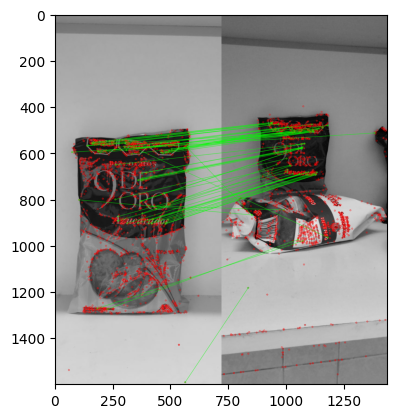

(<matplotlib.image.AxesImage at 0x7adf5065ea40>, None)

In [7]:
# Cargar imágenes en escala de grises
img1 = cv.imread('/content/computer_vision/unidad1/imagen1.jpeg', cv.IMREAD_GRAYSCALE)          # Imagen de consulta (queryImage)
img2 = cv.imread('/content/computer_vision/unidad1/imagen2.jpeg', cv.IMREAD_GRAYSCALE) # Imagen de entrenamiento (trainImage)

# Iniciar el detector SIFT
sift = cv.SIFT_create()

# Encontrar los keypoints y descriptores con SIFT
kp1, des1 = sift.detectAndCompute(img1, None)
kp2, des2 = sift.detectAndCompute(img2, None)

# Parámetros FLANN
FLANN_INDEX_KDTREE = 1
index_params = dict(algorithm=FLANN_INDEX_KDTREE, trees=5)
search_params = dict(checks=50)  # o pasar un diccionario vacío

# Iniciar FLANN matcher
flann = cv.FlannBasedMatcher(index_params, search_params)

# Realizar emparejamientos kNN
matches = flann.knnMatch(des1, des2, k=2)

# Necesitamos dibujar solo los buenos emparejamientos, por lo que creamos una máscara
matchesMask = [[0, 0] for i in range(len(matches))]

# Test de proporción según el artículo de Lowe (https://www.robots.ox.ac.uk/~vgg/research/affine/det_eval_files/lowe_ijcv2004.pdf)
for i, (m, n) in enumerate(matches):
    if m.distance < 0.7 * n.distance:
        matchesMask[i] = [1, 0]

# Parámetros de dibujo para los emparejamientos
draw_params = dict(matchColor=(0, 255, 0),  # color de los emparejamientos
                   singlePointColor=(255, 0, 0),  # color de los puntos individuales
                   matchesMask=matchesMask,  # máscara para seleccionar emparejamientos
                   flags=cv.DrawMatchesFlags_DEFAULT)

# Dibujar los emparejamientos kNN
img3 = cv.drawMatchesKnn(img1, kp1, img2, kp2, matches, None, **draw_params)

# Mostrar la imagen resultante
plt.imshow(img3), plt.show()

# Ejercicio 4
Con los videos de [youtube.com](http://youtube.com) de cámara fija pedidos para esta clase, aplicar los algoritmos de detección de movimiento vistos en la teoría.


In [8]:
!pip install mediapy

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 6.2 MB/s eta 0:00:00


In [9]:
from google.colab.patches import cv2_imshow

In [10]:
%%capture
# Instalar la biblioteca pytube
!pip install pytube
!apt update && apt install -y handbrake

from pytube import YouTube

# URL del video de YouTube
url = 'https://www.youtube.com/watch?v=8s5P2nZNJpw'

# Crear un objeto YouTube
yt = YouTube(url)

# Seleccionar el stream con resolución de 720p
video = yt.streams.filter(progressive=True, file_extension='mp4', res="720p").first()

# Nombre del archivo de salida
output_filename = 'carrera.mp4'

# Descargar el video con el nombre especificado
video.download(filename=output_filename)

print("Descarga completada.")

In [11]:
# Función actualizada para realizar diferencia de fotogramas con normalización:
def process_frame_difference(new_image, prev_image, **kwargs):
    # Convertir las imágenes a escala de grises
    new_gray = cv2.cvtColor(new_image, cv2.COLOR_RGB2GRAY)
    prev_gray = cv2.cvtColor(prev_image, cv2.COLOR_RGB2GRAY)

    # Calcular la diferencia absoluta entre los fotogramas actual y anterior
    frame_diff = cv2.absdiff(new_gray, prev_gray)

    # Normalizar la imagen de diferencia
    norm_diff = cv2.normalize(frame_diff, None, 0, 255, cv2.NORM_MINMAX)

    # Umbralizar la imagen para resaltar las diferencias
    _, thresh = cv2.threshold(norm_diff, 100, 255, cv2.THRESH_BINARY)

    # Convertir la imagen umbralizada a color para mantener la consistencia con el video original
    thresh_color = cv2.cvtColor(thresh, cv2.COLOR_GRAY2RGB)

    return thresh_color

In [12]:
#Esto convierte el video a un formato más liviano de trabajo
#!ffmpeg -y -i '/content/computer_vision/unidad1/Catar 2022 - Argentina vs Francia - Gol Di Maria - Cámara Táctica.mp4' -vf "scale=600:-1" -an -t 30 highway_600.mp4
!ffmpeg -y -i '/content/computer_vision/carrera.mp4' -vf "scale=600:-1" -an -t 30 carrera_600.mp4

ffmpeg version 4.4.2-0ubuntu0.22.04.1 Copyright (c) 2000-2021 the FFmpeg developers
  built with gcc 11 (Ubuntu 11.2.0-19ubuntu1)
  configuration: --prefix=/usr --extra-version=0ubuntu0.22.04.1 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --arch=amd64 --enable-gpl --disable-stripping --enable-gnutls --enable-ladspa --enable-libaom --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libcodec2 --enable-libdav1d --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libjack --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librabbitmq --enable-librubberband --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libsrt --enable-libssh --enable-libtheora --enable-libtwolame --enable-libvidstab --enable-libvorbis --enable-libvpx --enab

In [16]:
# Nombres de los archivos de video de entrada y salida
filename_in = '/content/computer_vision/carrera_600.mp4'
filename_out = 'carrera_dark.mp4'

In [14]:
import mediapy as media  # Importar la biblioteca mediapy para manejo de medios
import cv2  # Importar OpenCV para el procesamiento de imágenes y videos
import numpy as np


# Función para oscurecer una imagen:
def process_image(new_image, prev_image, **kwargs):
    # Convertir la imagen a float32
    new_image_float = new_image.astype(np.float32)

    # Reducir el brillo de la imagen a la mitad
    new_image_float *= 0.7

    # Convertir la imagen de vuelta a uint8
    new_image_uint8 = np.clip(new_image_float, 0, 255).astype(np.uint8)

    return new_image_uint8

def draw_contours(frame, contours, color=(0, 255, 0), thickness=2):
    # Comprobar si la imagen es en escala de grises (1 canal)
    if len(frame.shape) == 2 or frame.shape[2] == 1:
        # Convertir la imagen de escala de grises a color (3 canales)
        result_image = cv2.cvtColor(frame, cv2.COLOR_GRAY2BGR)
    else:
        # Si ya es una imagen de color, simplemente hacer una copia
        result_image = frame.copy()

    # Dibujar cada contorno en la imagen
    for contour in contours:
        # Obtener el rectángulo delimitador para cada contorno
        x, y, w, h = cv2.boundingRect(contour)
        # Dibujar el rectángulo
        cv2.rectangle(result_image, (x, y), (x + w, y + h), color, thickness)

    return result_image

# Función para procesar un video:
def video_processor(filename_in, filename_out, process_func, max_time=10, **kwargs):
    # Abrir el video de entrada para lectura
    with media.VideoReader(filename_in) as r:
        # Crear un archivo de video de salida
        with media.VideoWriter(filename_out, shape=r.shape, fps=r.fps, bps=r.bps) as w:
            count = 0  # Inicializar contador de fotogramas
            prev_image = None  # Inicializar la imagen previa

            # Iterar sobre cada imagen (fotograma) del video
            for image in r:
                new_image = media.to_uint8(image)  # Convertir la imagen a formato flotante

                # Comprobar si es la primera imagen
                if prev_image is None:
                    prev_image = new_image.copy()

                # Procesar la imagen utilizando la función dada
                processed_image = process_func(new_image, prev_image, **kwargs)

                # Añadir la imagen procesada al video de salida
                w.add_image(processed_image)

                # Actualizar la imagen previa
                prev_image = new_image.copy()

                # Incrementar el contador de fotogramas
                count += 1

                # Detener el proceso si se alcanza el tiempo máximo
                if count >= max_time * r.fps:
                    break

# Función actualizada para realizar diferencia de fotogramas con normalización:
def process_frame_difference(new_image, prev_image, **kwargs):
    # Convertir las imágenes a escala de grises
    new_gray = cv2.cvtColor(new_image, cv2.COLOR_RGB2GRAY)
    prev_gray = cv2.cvtColor(prev_image, cv2.COLOR_RGB2GRAY)

    # Calcular la diferencia absoluta entre los fotogramas actual y anterior
    frame_diff = cv2.absdiff(new_gray, prev_gray)

    # Normalizar la imagen de diferencia
    norm_diff = cv2.normalize(frame_diff, None, 0, 255, cv2.NORM_MINMAX)

    # Umbralizar la imagen para resaltar las diferencias
    _, thresh = cv2.threshold(norm_diff, 100, 200, cv2.THRESH_BINARY)

    # Convertir la imagen umbralizada a color para mantener la consistencia con el video original
    thresh_color = cv2.cvtColor(thresh, cv2.COLOR_GRAY2RGB)

    return thresh_color


In [17]:
# Llamar a la función para procesar el video
video_processor(filename_in, filename_out, process_image, 10)

# Mostrar el video resultante
media.show_video(media.read_video(filename_out), fps=30)

In [18]:
deteccion = 'deteccion1.mp4'

# Llamar a la función para procesar el video
video_processor(filename_out, deteccion, process_frame_difference, 10)

# Mostrar el video resultante
media.show_video(media.read_video(deteccion), fps=30)

# Ejercicio 5
Genere un video en un patio o en un hall de edificio donde en un principio se vea vacío y luego aparezca una persona. Mediante los métodos de motion detection (sin usar deep learning) logre una detección de la persona cuando entra al cuadro suponiendo la utilidad para una cámara de seguridad.
Luego sobre el mismo video aplique los algoritmos de flujo denso y disperso que se mostraron en clase.
Escriba una reflexión sobre los resultados en el formato md dentro del Jupyter Notebook.

In [19]:
# Nombres de los archivos de video de entrada y salida
filename_in = '/content/computer_vision/unidad1/ejercicio5.mp4'
filename_out = '5-dark.mp4'

# Llamar a la función para procesar el video
video_processor(filename_in, filename_out, process_image, 10)

# Mostrar el video resultante
media.show_video(media.read_video(filename_out), fps=30)

In [20]:
deteccion2 = 'deteccion2.mp4'

In [21]:
# Llamar a la función para procesar el video
video_processor(filename_out, deteccion2, process_frame_difference, 10)

# Mostrar el video resultante
media.show_video(media.read_video(deteccion2), fps=30)

flujo optico disperso

In [22]:
def process_sparse_optical_flow(new_image, prev_image):
    # Preparamos las imagenes de trabajo
    new_gray = cv2.cvtColor(new_image, cv2.COLOR_BGR2GRAY)
    prev_gray_image = cv2.cvtColor(prev_image, cv2.COLOR_BGR2GRAY)

    # Verificar si ya se han detectado las características de Shi-Tomasi
    if not hasattr(process_sparse_optical_flow, "shi_tomasi_done"):
        # Definir parámetros para la detección de esquinas de Shi-Tomasi
        feature_params = dict(maxCorners=300, qualityLevel=0.2, minDistance=2, blockSize=7)
        # Detectar puntos característicos en la imagen
        process_sparse_optical_flow.prev_points = cv2.goodFeaturesToTrack(new_gray, mask=None, **feature_params)
        # Crear una máscara para dibujar el flujo óptico
        process_sparse_optical_flow.mask = np.zeros_like(new_image)
        # Marcar que se ha completado la detección de Shi-Tomasi
        process_sparse_optical_flow.shi_tomasi_done = True

    # Continuar si se ha completado la detección de Shi-Tomasi
    if process_sparse_optical_flow.shi_tomasi_done:
        prev_points = process_sparse_optical_flow.prev_points
        mask = process_sparse_optical_flow.mask

    # Parámetros para el flujo óptico de Lucas-Kanade
    lk_params = dict(winSize=(15, 15), maxLevel=2,
                     criteria=(cv2.TERM_CRITERIA_EPS | cv2.TERM_CRITERIA_COUNT, 10, 0.03))

    # Calcular el flujo óptico de Lucas-Kanade
    new_points, status, error = cv2.calcOpticalFlowPyrLK(prev_gray_image, new_gray, prev_points, None, **lk_params)
    # Filtrar puntos buenos
    good_old = prev_points[status == 1]
    good_new = new_points[status == 1]
    color = (0, 255, 0)  # Color para el dibujo
    # Dibujar el movimiento (flujo óptico)
    for i, (new, old) in enumerate(zip(good_new, good_old)):
        a, b = new.astype(int).ravel()
        c, d = old.astype(int).ravel()
        mask = cv2.line(mask, (a, b), (c, d), color, 2)
        new_image = cv2.circle(new_image, (a, b), 3, color, -1)

    # Combinar la imagen actual con las líneas de flujo óptico dibujadas
    output = cv2.add(new_image, mask)
    # Actualizar puntos para el siguiente cuadro
    process_sparse_optical_flow.prev_points = good_new.reshape(-1, 1, 2)
    return output

# Nombres de los archivos de video de entrada y salida
filename_in = '/content/computer_vision/unidad1/ejercicio5.mp4'
filename_out = 'highway_process_sparse_optical_flow.mp4'

# Llamar a la función para procesar el video
video_processor(filename_in, filename_out, process_sparse_optical_flow,
                max_time=10)

# Mostrar el video resultante
media.show_video(media.read_video(filename_out), fps=30)

flujo optico denso

In [23]:
# Función para procesar el flujo óptico denso
def process_dense_optical_flow(new_image, prev_image):
    # Convierte la nueva imagen a escala de grises
    gray = cv2.cvtColor(new_image, cv2.COLOR_BGR2GRAY)

    if not hasattr(process_dense_optical_flow, "init_done"):
        process_dense_optical_flow.prev_gray = cv2.cvtColor(new_image, cv2.COLOR_BGR2GRAY)
        process_dense_optical_flow.mask = np.zeros_like(new_image)
        process_dense_optical_flow.mask[..., 1] = 255
        process_dense_optical_flow.init_done = True

    if process_dense_optical_flow.init_done:
        prev_gray = process_dense_optical_flow.prev_gray
        mask = process_dense_optical_flow.mask

    # Calcula el flujo óptico
    flow = cv2.calcOpticalFlowFarneback(prev_gray, gray, None, 0.5, 3, 15, 3, 5, 1.2, 0)
    # Computa magnitud y ángulo de los vectores 2D
    magnitude, angle = cv2.cartToPolar(flow[..., 0], flow[..., 1])
    # Establece el tono de la imagen según la dirección del flujo óptico
    mask[..., 0] = angle * 180 / np.pi / 2
    # Establece el valor de la imagen según la magnitud del flujo óptico
    mask[..., 2] = cv2.normalize(magnitude, None, 0, 255, cv2.NORM_MINMAX)
    # Convierte de HSV a RGB
    rgb = cv2.cvtColor(mask, cv2.COLOR_HSV2BGR)
    # Actualiza la imagen previa a gris
    process_dense_optical_flow.prev_grayprev_gray = gray.copy()
    return rgb

# Nombres de los archivos de video de entrada y salida
filename_in = '/content/computer_vision/unidad1/ejercicio5.mp4'
filename_out = 'highway_process_dense_optical_flow.mp4'

# Llamar a la función para procesar el video
video_processor(filename_in, filename_out, process_dense_optical_flow,
                max_time=20)

# Mostrar el video resultante
media.show_video(media.read_video(filename_out), fps=30)

Conclusion, se detectan movimientos en otros puntos ademas de la persona, pero con el flujo optico podemos ver bien la diferencia, que el flujo es mucho mayor.

# Ejercicio 6
Explique cuál es diferencia entre localización de objetos y clasificación de imágenes. Muestre ejemplos de ello.

**Clasificacion de imagenes:**

Es detectar en una imagen en particular, que es lo que aparece, por ejemplo, tomando del video anterior solo la imagen de cuando la persona entra en escena, detectar que es una persona.

**Localizacion de objetos:**

Se trata de identificar cada objeto dentro de la imagen, y delimitar estos con un bounding box, que me muestra la localización precisa de cada objeto. Por ejemplo si hay en la imagen una persona, un perro y un auto, obtener las coordenadas del rectangulo que deliminita cada uno de los 3 objetos.

# Ejercicio 8
En lo posible, realizar videos donde una clase de objeto difiera en número con otros objetos (sino, utilizar videos bajados de internet). Por ejemplo, al aire libre, un perro que se mueva entre personas en un parque. Una persona en bicicleta entre muchos autos en una calle de la ciudad. Luego, utilizar los distintos algoritmos presentados en teoría para detectar solo la clase minoritaria con su respectiva etiqueta. Indicando en cada caso la herramienta utilizada y comparando los niveles de confianza de detección logrados.

In [24]:
!pip install -q supervision ultralytics
import mediapy as media  # Importar la biblioteca mediapy para manejo de medios
import cv2  # Importar OpenCV para el procesamiento de imágenes y videos
import numpy as np
from ultralytics import YOLO


MODEL_NAME = "yolov8x.pt"  # Nombre del modelo preentrenado de YOLO a utilizar
# Inicializar el modelo de detección
model = YOLO(MODEL_NAME)  # Cargar el modelo de YOLO

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 111.0/111.0 kB 1.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 756.5/756.5 kB 7.3 MB/s eta 0:00:00


100%|██████████| 131M/131M [00:00<00:00, 208MB/s]


In [25]:
# Función para detectar objetos en una imagen:
def detect_objects(new_image, prev_image, **kwargs):
    # Convertir la imagen a float32
    results = model(new_image)

    # Clases de interés para graficar
    classes = kwargs.get('classes', ['person','bus', 'car', 'truck','bicycle'])

    # Iteramos sobre los boung boxes obtenidos
    for box in results[0].boxes:
        # Extrayendo los datos del tensor
        x1, y1, x2, y2, confidence, cls = box.data[0]

        # Obteniendo el nombre de la clase
        class_name = model.names[int(cls)]

        # Parámetros opcionales del bounding box
        color = kwargs.get('color', (0, 255, 0))
        thickness = kwargs.get('thickness', 2)

        if class_name in classes:
            # Dibujar el rectángulo
            cv2.rectangle(new_image, (int(x1), int(y1)), (int(x2), int(y2)), color, thickness)

            # Agregar el texto de la confianza
            confidence_text = f"{class_name}: {confidence:.2f}"
            cv2.putText(new_image, confidence_text, (int(x1), int(y1)-10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, color, 2)

    return new_image

# Función para procesar un video:
def video_processor(filename_in, filename_out, process_func, max_time=10, **kwargs):
    # Abrir el video de entrada para lectura
    with media.VideoReader(filename_in) as r:
        # Crear un archivo de video de salida
        with media.VideoWriter(filename_out, shape=r.shape, fps=r.fps, bps=r.bps) as w:
            count = 0  # Inicializar contador de fotogramas
            prev_image = None  # Inicializar la imagen previa

            # Iterar sobre cada imagen (fotograma) del video
            for image in r:
                new_image = media.to_uint8(image)  # Convertir la imagen a formato flotante

                # Comprobar si es la primera imagen
                if prev_image is None:
                    prev_image = new_image.copy()

                # Procesar la imagen utilizando la función dada
                processed_image = process_func(new_image, prev_image, **kwargs)

                # Añadir la imagen procesada al video de salida
                w.add_image(processed_image)

                # Actualizar la imagen previa
                prev_image = new_image.copy()

                # Incrementar el contador de fotogramas
                count += 1

                # Detener el proceso si se alcanza el tiempo máximo
                if count >= max_time * r.fps:
                    break

In [26]:
# Nombres de los archivos de video de entrada y salida
filename_in = '/content/computer_vision/unidad1/video6.mp4'
filename_out = 'video_salida.mp4'
parameters = dict(classes=['bicycle'])

# Llamar a la función para procesar el video
video_processor(filename_in, filename_out, detect_objects, 20, **parameters)

# Mostrar el video resultante
media.show_video(media.read_video(filename_out), fps=30)


0: 640x384 3 persons, 3 cars, 1 bus, 2 trains, 5782.4ms
Speed: 9.2ms preprocess, 5782.4ms inference, 7434.7ms postprocess per image at shape (1, 3, 640, 384)

0: 640x384 3 persons, 2 cars, 1 bus, 2 trains, 6884.0ms
Speed: 5.8ms preprocess, 6884.0ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 384)

0: 640x384 3 persons, 2 cars, 1 bus, 2 trains, 6443.9ms
Speed: 3.2ms preprocess, 6443.9ms inference, 2.8ms postprocess per image at shape (1, 3, 640, 384)

0: 640x384 4 persons, 3 cars, 1 bus, 2515.4ms
Speed: 5.6ms preprocess, 2515.4ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 384)

0: 640x384 3 persons, 3 cars, 1 bus, 2 trains, 2499.3ms
Speed: 4.6ms preprocess, 2499.3ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 384)

0: 640x384 4 persons, 3 cars, 1 bus, 1 train, 3524.1ms
Speed: 3.6ms preprocess, 3524.1ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 384)

0: 640x384 3 persons, 4 cars, 1 bus, 2888.5ms
Speed: 3.4ms preprocess, 

# Ejercicio 9

 Tomar fotografías donde coexistan varios objetos en posiciones solapadas y no, en contextos de diferente complejidad. Luego, aplicar los algoritmos de segmentación propuestos y verificar los resultados de cada uno. Comentar qué diferencias observa.

## Segmentación con algoritmo Watershed (OpenCV)

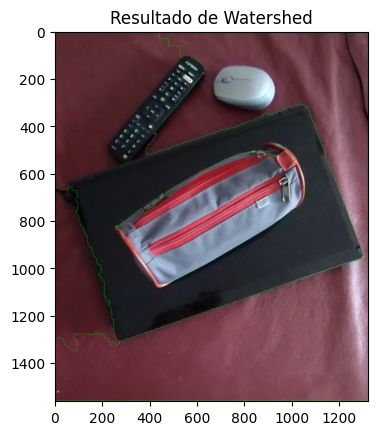

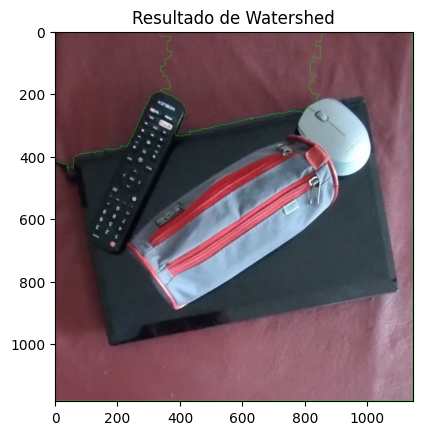

In [27]:
images = ['/content/computer_vision/unidad1/imagen11.jpeg', '/content/computer_vision/unidad1/imagen12.jpeg']

for image_path in images:
    img = cv2.imread(image_path)
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    blur = cv2.GaussianBlur(gray, (5, 5), 0)

    # Binarización de la imagen
    _, thresh = cv2.threshold(blur, 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU)

    # Eliminación de ruido
    kernel = np.ones((3,3), np.uint8)
    opening = cv2.morphologyEx(thresh, cv2.MORPH_OPEN, kernel, iterations=2)

    # Seguro fondo área
    sure_bg = cv2.dilate(opening, kernel, iterations=3)

    # Encontrar área segura del frente
    dist_transform = cv2.distanceTransform(opening, cv2.DIST_L2, 5)
    _, sure_fg = cv2.threshold(dist_transform, 0.7*dist_transform.max(), 255, 0)

    # Encontrar región desconocida
    sure_fg = np.uint8(sure_fg)
    unknown = cv2.subtract(sure_bg, sure_fg)

    # Etiquetado de marcadores
    _, markers = cv2.connectedComponents(sure_fg)

    # Añadir uno a todos los marcadores para asegurar que el fondo sea 1 en lugar de 0
    markers = markers+1

    # Marcar la región desconocida con cero
    markers[unknown==255] = 0

    # Aplicar el algoritmo Watershed
    markers = cv2.watershed(img, markers)
    img[markers == -1] = [0, 255, 0]

    # Visualizar el resultado
    plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    plt.title('Resultado de Watershed')
    plt.show()

Con este algoritmo se logra una segmentacion muy pobre, donde ninguno de los objetos logra ser completamente segmentado

## Instance Segmentation con modelo PointRend Resnet50 (PixelLib)

In [28]:
%%capture
!pip install pixellib torchvision
# Instance segmentation model
!wget "https://github.com/ayoolaolafenwa/PixelLib/releases/download/0.2.0/pointrend_resnet50.pkl" -O pointrend_resnet50.pkl

  proposal_generator.anchor_generator.cell_anchors.{0, 1, 2, 3, 4}
/usr/local/lib/python3.10/dist-packages/torch/functional.py:507: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3549.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


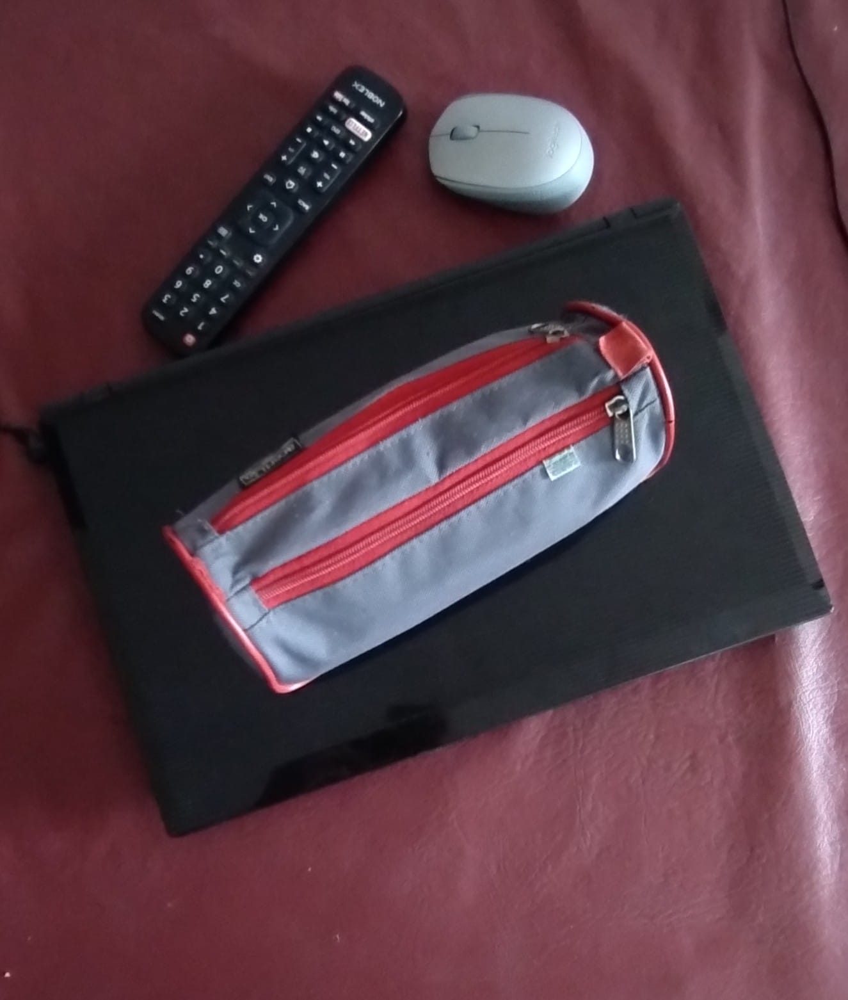

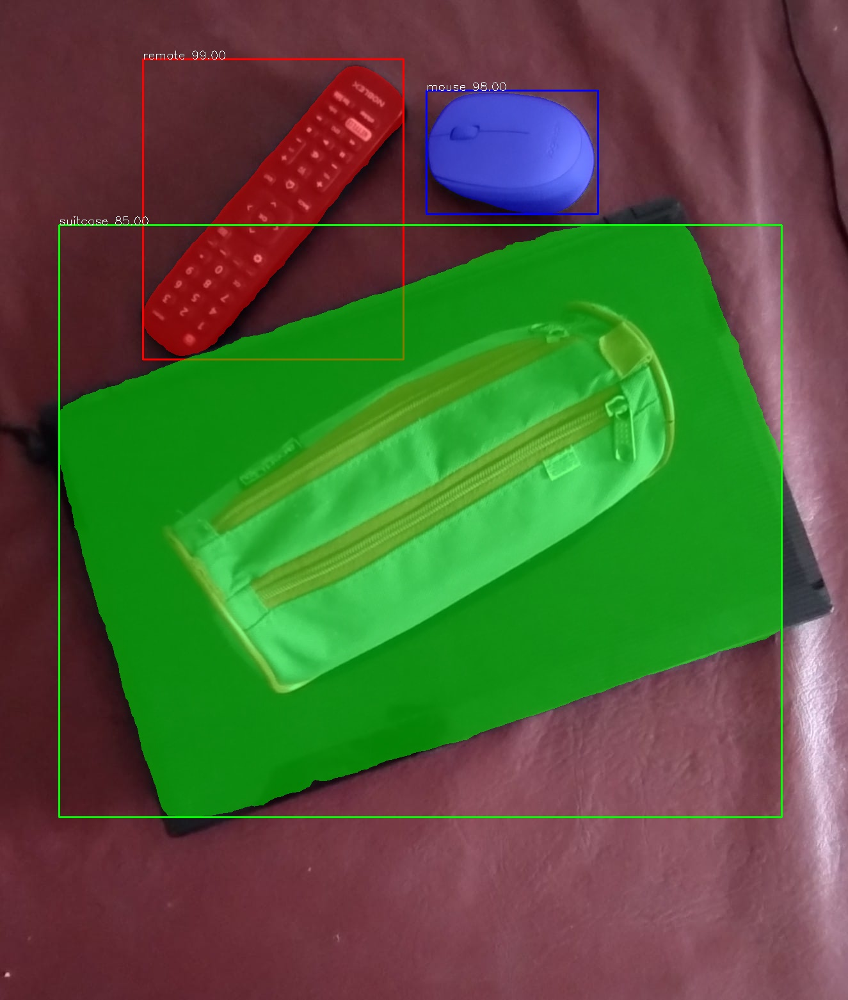

In [29]:
# Importación de las bibliotecas necesarias
import pixellib
from pixellib.torchbackend.instance import instanceSegmentation
from IPython.display import Image

# Creación de una instancia del modelo de segmentación
ins = instanceSegmentation()

# Carga del modelo preentrenado
ins.load_model("pointrend_resnet50.pkl")

# Segmentación de la imagen y guardado de la imagen segmentada con las cajas delimitadoras
ins.segmentImage("/content/computer_vision/unidad1/imagen11.jpeg", show_bboxes=True, output_image_name="imagen11_segmented.jpg")

# Muestra la imagen original
display(Image(filename="/content/computer_vision/unidad1/imagen11.jpeg"))

# Muestra la imagen segmentada
display(Image(filename="imagen11_segmented.jpg"))

Con este modelo se pudo lograr una buena segmentacion, reconociendo ademas los objetos, el unico problema fue en los objetos solapados, la cartuchera arriba de la notebook la segmento como si fuera solo una cartuchera.

## SAM (Segment Anything Model)

In [35]:
!{sys.executable} -m pip install opencv-python matplotlib
!{sys.executable} -m pip install 'git+https://github.com/facebookresearch/segment-anything.git'
!{sys.executable} -m pip install -q jupyter_bbox_widget roboflow dataclasses-json supervision

!wget https://dl.fbaipublicfiles.com/segment_anything/sam_vit_h_4b8939.pth

  Cloning https://github.com/facebookresearch/segment-anything.git to /tmp/pip-req-build-ddi3vbj6
  Running command git clone --filter=blob:none --quiet https://github.com/facebookresearch/segment-anything.git /tmp/pip-req-build-ddi3vbj6
  Resolved https://github.com/facebookresearch/segment-anything.git to commit 6fdee8f2727f4506cfbbe553e23b895e27956588
  Preparing metadata (setup.py) ... done
  Created wheel for segment-anything: filename=segment_anything-1.0-py3-none-any.whl size=36590 sha256=e223e6b295b076c25f848b922b0ec48f11a0602e28a075abc5e94f4f4f434bdc
  Stored in directory: /tmp/pip-ephem-wheel-cache-8ipenngy/wheels/10/cf/59/9ccb2f0a1bcc81d4fbd0e501680b5d088d690c6cfbc02dc99d
Successfully built segment-anything
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 367.8/367.8 kB 3.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 74.6/74.6 kB 7.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 158.3/158.3 kB 16.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━

In [5]:
import supervision as sv

In [ ]:
import sys
sys.path.append("..")
from segment_anything import sam_model_registry, SamAutomaticMaskGenerator, SamPredictor

sam_checkpoint = "/content/computer_vision/sam_vit_h_4b8939.pth"
model_type = "vit_h"

device = "cuda"

sam = sam_model_registry[model_type](checkpoint=sam_checkpoint)
sam.to(device=device)

In [8]:
images = ['/content/computer_vision/unidad1/imagen11.jpeg', '/content/computer_vision/unidad1/imagen12.jpeg']


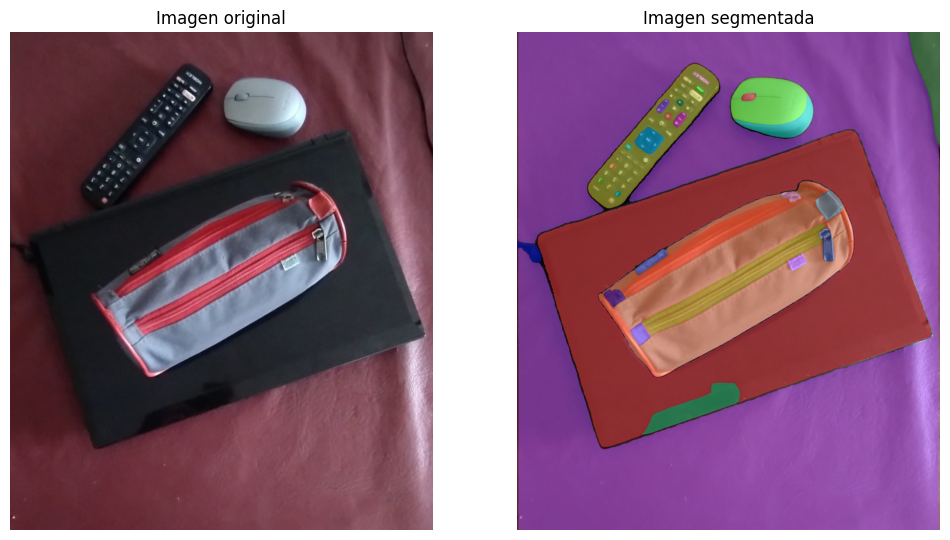

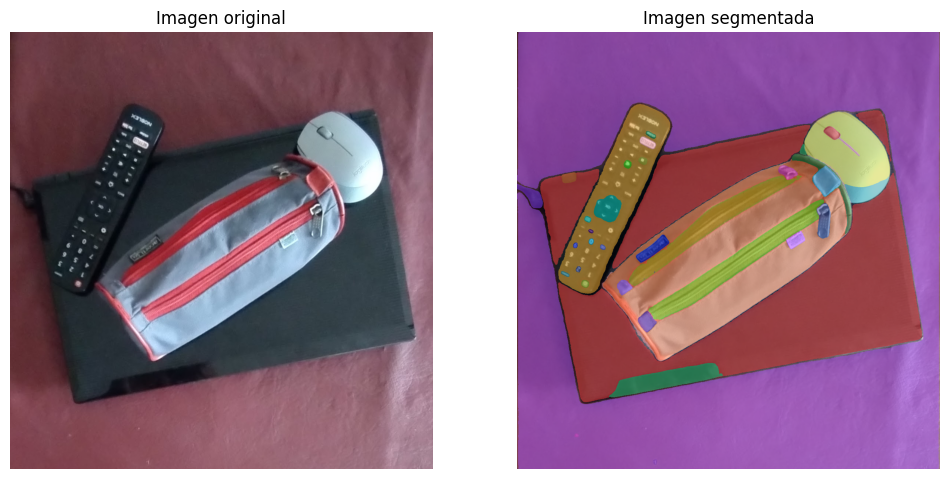

In [11]:
# Inicializar el anotador de máscaras con una búsqueda de color por índice
mask_annotator = sv.MaskAnnotator(color_lookup=sv.ColorLookup.INDEX)

# Inicializar el generador de máscaras automáticas SAM
mask_generator = SamAutomaticMaskGenerator(sam)

# Iterar sobre cada imagen en la lista
for imagen_path in images:
    # Cargar la imagen y convertirla de BGR a RGB
    image_bgr = cv2.imread(imagen_path)
    image_rgb = cv2.cvtColor(image_bgr, cv2.COLOR_BGR2RGB)

    # Generar máscaras automáticamente para la imagen RGB
    sam_result = mask_generator.generate(image_rgb)
    # Convertir el resultado de SAM en detecciones
    detections = sv.Detections.from_sam(sam_result=sam_result)

    # Anotar la imagen con las detecciones generadas por SAM
    annotated_image = mask_annotator.annotate(scene=image_bgr.copy(), detections=detections)

    # Mostrar la imagen original y la anotada en una cuadrícula
    sv.plot_images_grid(
        images=[image_bgr, annotated_image],
        grid_size=(1, 2),
        titles=['Imagen original', 'Imagen segmentada']
    )

Utilizando SAM se logro segmentar todos los objetos, aunque tambien se segmentaron detalles dentro de los objetos, que no tienen demasiada importancia.

# Ejercicio 10
 Con el mismo video usado en el ejercicio 4, realice un seguimiento de objetos con el código propuesto en la sección de ejemplos prácticos.

In [40]:
!pip install -q supervision ultralytics

In [42]:
# Importar las librerías necesarias
import supervision as sv  # Librería para el seguimiento de objetos
from ultralytics import YOLO  # Librería para la detección de objetos con YOLO
import numpy as np  # Librería para operaciones matemáticas y manejo de arrays
import mediapy as media

# Definir rutas de los videos de entrada y salida, y el nombre del modelo
SOURCE_VIDEO_PATH = "/content/computer_vision/carrera_dark.mp4"  # Ruta al video de entrada
TARGET_VIDEO_PATH = "carrera_tracking.mp4"  # Ruta donde se guardará el video con seguimiento de objetos
MODEL_NAME = "yolov8x.pt"  # Nombre del modelo preentrenado de YOLO a utilizar

# Inicializar el modelo de detección y el rastreador de objetos
model = YOLO(MODEL_NAME)  # Cargar el modelo de YOLO
tracker = sv.ByteTrack()  # Inicializar ByteTrack para el seguimiento de objetos

# Inicializar los anotadores para las cajas delimitadoras y las etiquetas
bounding_box_annotator = sv.BoundingBoxAnnotator()  # Para dibujar cajas delimitadoras
label_annotator = sv.LabelAnnotator()  # Para dibujar etiquetas (IDs de seguimiento)

# Definir la función de callback que procesa cada frame
def callback(frame: np.ndarray, index: int) -> np.ndarray:
    results = model(frame)[0]  # Detectar objetos en el frame actual con YOLO
    detections = sv.Detections.from_ultralytics(results)  # Convertir resultados a formato de supervision
    detections = tracker.update_with_detections(detections)  # Actualizar el estado del rastreador con las detecciones

    labels = [f"#{tracker_id}" for tracker_id in detections.tracker_id]  # Crear etiquetas con los IDs de seguimiento

    # Anotar el frame con bounding boxes y etiquetas
    annotated_frame = bounding_box_annotator.annotate(
        scene=frame.copy(), detections=detections)
    annotated_frame = label_annotator.annotate(
        scene=annotated_frame, detections=detections, labels=labels)
    return annotated_frame  # Devolver el frame anotado



# Procesar el video: leer, aplicar callback a cada frame y guardar el resultado
sv.process_video(
    source_path=SOURCE_VIDEO_PATH,  # Ruta del video original
    target_path=TARGET_VIDEO_PATH,  # Ruta del video resultante
    callback=callback  # Función de callback para procesar cada frame
)






0: 384x640 1 person, 1 car, 2676.5ms
Speed: 39.0ms preprocess, 2676.5ms inference, 46.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 person, 1 car, 3607.3ms
Speed: 4.1ms preprocess, 3607.3ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 person, 1 car, 2514.9ms
Speed: 6.4ms preprocess, 2514.9ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 person, 1 car, 2407.6ms
Speed: 4.5ms preprocess, 2407.6ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 person, 1 car, 2436.6ms
Speed: 3.0ms preprocess, 2436.6ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 person, 1 car, 2488.2ms
Speed: 4.5ms preprocess, 2488.2ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 person, 1 car, 3738.2ms
Speed: 4.6ms preprocess, 3738.2ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 person, 1 car, 2416.5ms
S

In [43]:
# Mostrar el video resultante
media.show_video(media.read_video(TARGET_VIDEO_PATH), fps=30)


# Ejercicio 11
 Tome fotos donde se vea su rostro y el de varias personas. Asegúrese de tener fotos que tengan uno, dos y más caras diferentes. Implemente la librería OpenCV para la detección de rostros en ambos casos. Analice paso a paso el código que permite la detección de elementos de un rostro.

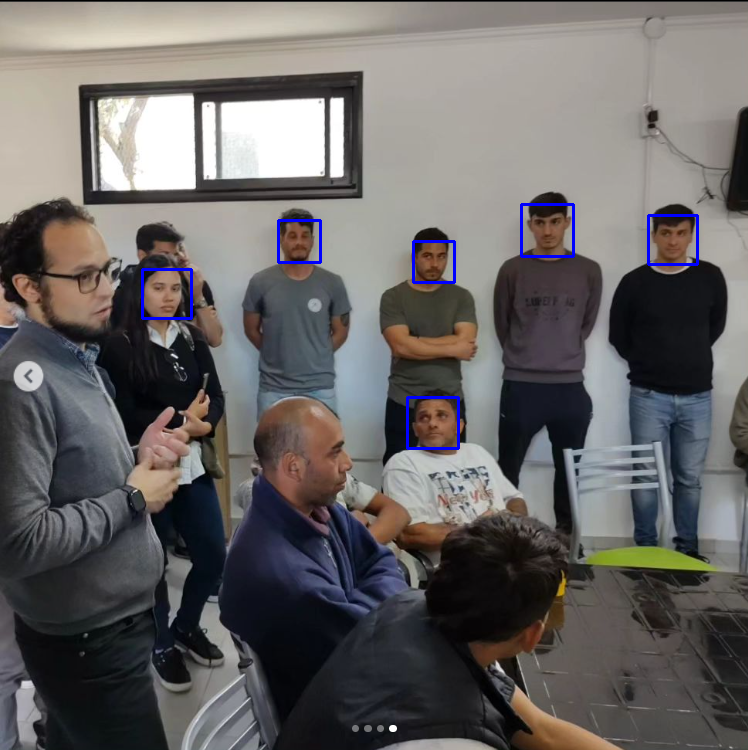

In [44]:
import cv2
from google.colab.patches import cv2_imshow

# Cargar los clasificadores preentrenados
face_cascade = cv2.CascadeClassifier(cv2.data.haarcascades + 'haarcascade_frontalface_default.xml')
eye_cascade = cv2.CascadeClassifier(cv2.data.haarcascades + 'haarcascade_eye.xml')
smile_cascade = cv2.CascadeClassifier(cv2.data.haarcascades + 'haarcascade_smile.xml')

# Cargar la imagen y convertirla a escala de grises
image = cv2.imread('/content/computer_vision/unidad1/face_test.png')
gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

# Detectar rostros en la imagen
faces = face_cascade.detectMultiScale(gray, 1.3, 5)

for (x,y,w,h) in faces:
    cv2.rectangle(image,(x,y),(x+w,y+h),(255,0,0),2)
    roi_gray = gray[y:y+h, x:x+w]
    roi_color = image[y:y+h, x:x+w]

    # Detectar ojos dentro del área del rostro
    eyes = eye_cascade.detectMultiScale(roi_gray)
    for (ex,ey,ew,eh) in eyes:
        cv2.rectangle(roi_color,(ex,ey),(ex+ew,ey+eh),(0,255,0),2)

    # Detectar sonrisa dentro del área del rostro
    mouth = smile_cascade.detectMultiScale(roi_gray)
    for (mx,my,mw,mh) in mouth:
        cv2.rectangle(roi_color,(mx,my),(mx+mw,my+mh),(0,0,255),2)

# Mostrar la imagen resultante
cv2_imshow(image)


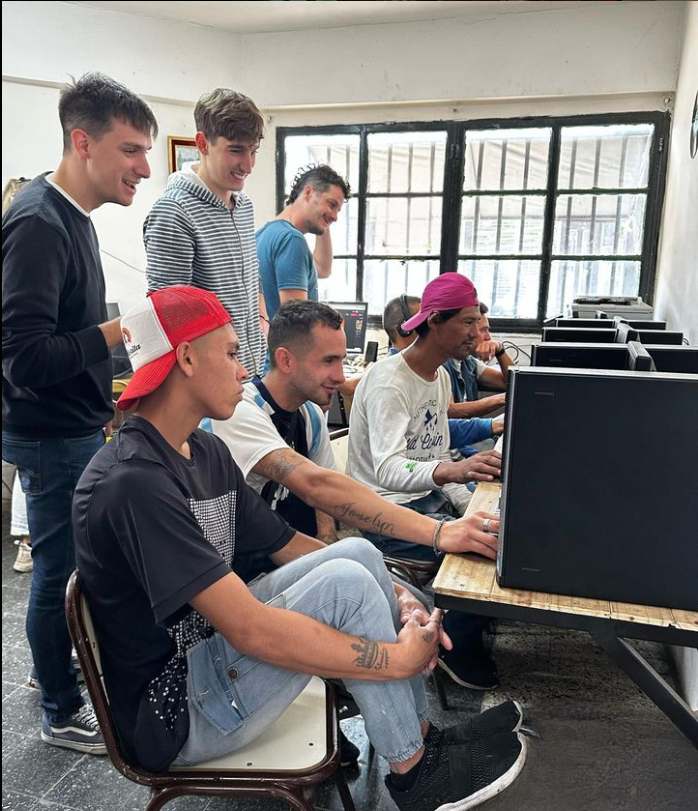

In [45]:
# Cargar la imagen y convertirla a escala de grises
image = cv2.imread('/content/computer_vision/unidad1/face_test2.png')
gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

# Detectar rostros en la imagen
faces = face_cascade.detectMultiScale(gray, 1.3, 5)

for (x,y,w,h) in faces:
    cv2.rectangle(image,(x,y),(x+w,y+h),(255,0,0),2)
    roi_gray = gray[y:y+h, x:x+w]
    roi_color = image[y:y+h, x:x+w]

    # Detectar ojos dentro del área del rostro
    eyes = eye_cascade.detectMultiScale(roi_gray)
    for (ex,ey,ew,eh) in eyes:
        cv2.rectangle(roi_color,(ex,ey),(ex+ew,ey+eh),(0,255,0),2)

    # Detectar sonrisa dentro del área del rostro
    mouth = smile_cascade.detectMultiScale(roi_gray)
    for (mx,my,mw,mh) in mouth:
        cv2.rectangle(roi_color,(mx,my),(mx+mw,my+mh),(0,0,255),2)

# Mostrar la imagen resultante
cv2_imshow(image)

Aqui no reconoce ninguna cara ya que estan de costado y tienen que estar completas

#Ejercicio 12
Tome fotos donde sólo se vea un rostro (suyo o de otras personas) desde distintos ángulos y en distintas posturas. Luego, utilizando la librería DeepFace verifique, comparando dichas fotos, si los rostros corresponden a la misma persona o no.

In [46]:
!pip install deepface

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 97.3/97.3 kB 1.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.3/2.3 MB 13.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 84.4/84.4 kB 9.9 MB/s eta 0:00:00


In [47]:
# Ruta de las imágenes que deseas comparar
image1 = "/content/computer_vision/unidad1/messi1.jpg"
image2 = "/content/computer_vision/unidad1/messi2.jpg"
image3 = "/content/computer_vision/unidad1/messi3.jpg"
image4 = "/content/computer_vision/unidad1/messi4.jpg"
image5 = "/content/computer_vision/unidad1/messi5.jpg"

messi = [image1,image2,image3,image4,image5]

In [48]:
from deepface import DeepFace

# Modelos soportados
models = [
  "VGG-Face",
  "Facenet",
  "Facenet512",
  "OpenFace",
  "DeepFace",
  "DeepID",
  "ArcFace",
  "Dlib",
  "SFace",
]

# Métodos disponibles para el cálculo de distancia
metrics = ["cosine", "euclidean", "euclidean_l2"]

# Verificar si las imágenes pertenecen a la misma persona
result = DeepFace.verify(img1_path = image1, img2_path = image2, model_name=models[6], distance_metric = metrics[1])
print("¿Son la misma persona?: 1y2", result["verified"])

# Verificar si las imágenes pertenecen a la misma persona
result = DeepFace.verify(img1_path = image1, img2_path = image3, model_name=models[6], distance_metric = metrics[1])
print("¿Son la misma persona?: 1y3", result["verified"])

# Verificar si las imágenes pertenecen a la misma persona
result = DeepFace.verify(img1_path = image1, img2_path = image4, model_name=models[6], distance_metric = metrics[1])
print("¿Son la misma persona?: 1y4", result["verified"])

# Verificar si las imágenes pertenecen a la misma persona
result = DeepFace.verify(img1_path = image1, img2_path = image5, model_name=models[6], distance_metric = metrics[1])
print("¿Son la misma persona?: 1y5", result["verified"])

# Verificar si las imágenes pertenecen a la misma persona
result = DeepFace.verify(img1_path = image2, img2_path = image3, model_name=models[6], distance_metric = metrics[1])
print("¿Son la misma persona?: 2y3", result["verified"])

# Verificar si las imágenes pertenecen a la misma persona
result = DeepFace.verify(img1_path = image2, img2_path = image4, model_name=models[6], distance_metric = metrics[1])
print("¿Son la misma persona?: 2y4", result["verified"])

# Verificar si las imágenes pertenecen a la misma persona
result = DeepFace.verify(img1_path = image2, img2_path = image5, model_name=models[6], distance_metric = metrics[1])
print("¿Son la misma persona?: 2y5", result["verified"])

# Verificar si las imágenes pertenecen a la misma persona
result = DeepFace.verify(img1_path = image3, img2_path = image4, model_name=models[6], distance_metric = metrics[1])
print("¿Son la misma persona?: 3y4", result["verified"])

# Verificar si las imágenes pertenecen a la misma persona
result = DeepFace.verify(img1_path = image3, img2_path = image5, model_name=models[6], distance_metric = metrics[1])
print("¿Son la misma persona?: 3y5", result["verified"])

# Verificar si las imágenes pertenecen a la misma persona
result = DeepFace.verify(img1_path = image4, img2_path = image5, model_name=models[6], distance_metric = metrics[1])
print("¿Son la misma persona?: 4y5", result["verified"])

24-05-09 23:26:17 - Directory /root/.deepface created
24-05-09 23:26:17 - Directory /root/.deepface/weights created
24-05-09 23:26:23 - arcface_weights.h5 will be downloaded to /root/.deepface/weights/arcface_weights.h5


Downloading...
From: https://github.com/serengil/deepface_models/releases/download/v1.0/arcface_weights.h5
To: /root/.deepface/weights/arcface_weights.h5
100%|██████████| 137M/137M [00:02<00:00, 54.8MB/s]


¿Son la misma persona?: 1y2 True
¿Son la misma persona?: 1y3 True
¿Son la misma persona?: 1y4 False
¿Son la misma persona?: 1y5 True
¿Son la misma persona?: 2y3 True
¿Son la misma persona?: 2y4 False
¿Son la misma persona?: 2y5 False
¿Son la misma persona?: 3y4 True
¿Son la misma persona?: 3y5 True
¿Son la misma persona?: 4y5 False


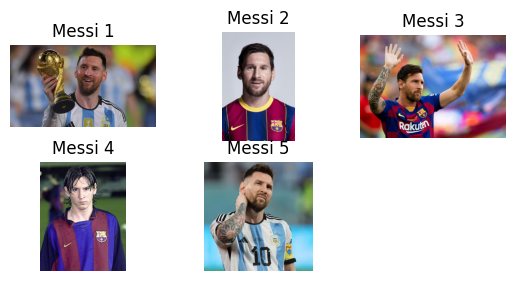

In [49]:
import matplotlib.pyplot as plt

#Muestro las imagenes con las que trabajare
for i, image in enumerate(messi):
    image = cv2.imread(image)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    ax = plt.subplot(3, 3, i + 1)
    plt.imshow(image)
    plt.title(f'Messi {str(i+1)}')
    plt.axis("off")

Se han obtenidos buenos resultados en las fotos mas simples, pero en la foto 5 al estar el brazo sobre la cara puede confundir. La foto de Messi mas joven solo con una imagen se reconocio que es la misma persona.




# Ejercicio 13
Experimente creando un programa que reemplace caras por un emoji que corresponda a la expresión de la cara en cuestión.  Analice si puede realizarlo en tiempo real.

In [2]:
emojis = ["/content/computer_vision/unidad1/emociones/surprise.jpg","/content/computer_vision/unidad1/emociones/neutral.png","/content/computer_vision/unidad1/emociones/fear.png","/content/computer_vision/unidad1/emociones/happy.jpg","/content/computer_vision/unidad1/emociones/disgust.jpg","/content/computer_vision/unidad1/emociones/angry.jpg"]
surprise = cv2.imread(emojis[0])
neutral = cv2.imread(emojis[1])
fear = cv2.imread(emojis[2])
happy = cv2.imread(emojis[3])
disgust = cv2.imread(emojis[4])
angry = cv2.imread(emojis[5])

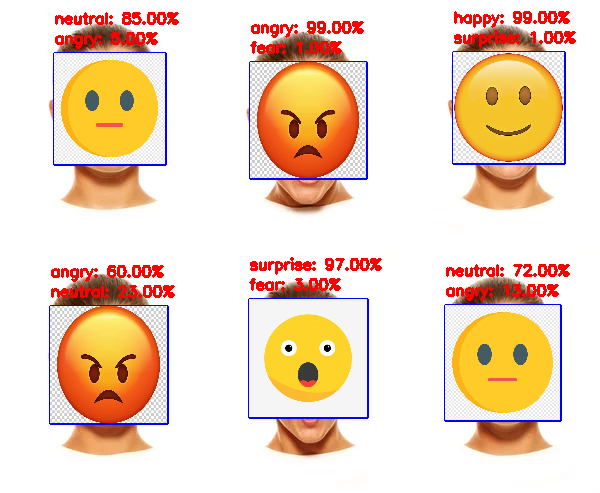

In [3]:
!pip install fer
from fer import FER
import cv2
from google.colab.patches import cv2_imshow

# Carga la imagen
img = cv2.imread("/content/computer_vision/unidad1/emociones/emociones-six-faces.jpg")

# Inicializa el detector
detector = FER()

# Detecta emociones en la imagen
resultados = detector.detect_emotions(img)

# Dibuja los bounding boxes y las dos emociones principales detectadas en la imagen
for resultado in resultados:
    # Obtiene las coordenadas del bounding box
    (x, y, w, h) = resultado["box"]

    # Dibuja un rectángulo alrededor de la cara
    cv2.rectangle(img, (x, y), (x + w, y + h), (255, 0, 0), 2)

    # Obtiene las emociones y las ordena por score de manera descendente
    emociones = resultado["emotions"]
    emociones_ordenadas = sorted(emociones.items(), key=lambda x: x[1], reverse=True)

    if emociones_ordenadas[0][0] == "surprise":
      emoji = surprise
    if emociones_ordenadas[0][0] == "neutral":
      emoji = neutral
    if emociones_ordenadas[0][0] == "fear":
      emoji = fear
    if emociones_ordenadas[0][0] == "happy":
      emoji = happy
    if emociones_ordenadas[0][0] == "disgust":
      emoji = disgust
    if emociones_ordenadas[0][0] == "angry":
      emoji = angry

    # Resize the emoji to match the ROI dimensions
    emoji = cv2.resize(emoji, (w, h))

    # Superponer las imágenes
    img[y:y+h, x:x+w] = emoji

    # Prepara el texto con las dos emociones principales y sus scores
    texto1 = "{}: {:.2f}%".format(emociones_ordenadas[0][0], emociones_ordenadas[0][1] * 100)
    texto2 = "{}: {:.2f}%".format(emociones_ordenadas[1][0], emociones_ordenadas[1][1] * 100)

    # Dibuja el texto de las emociones sobre el bounding box
    cv2.putText(img, texto1, (x, y - 30), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 0, 255), 2)
    cv2.putText(img, texto2, (x, y - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 0, 255), 2)


# Muestra la imagen modificada
cv2_imshow(img)

Pienso que se podria implementar en tiempo real, pero es muy dificil ya que el modelo muchas veces no reconoce la emocion correctamente, y filmando a una persona cambia su cara muy rapidamente por lo que complicaria aun mas las cosas. Y ademas se necesita de buena unidad de procesamiento para predecir lo mas rapido posible.